In [1]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [3]:
# !pip install pretrainedmodels
!pip install torch_optimizer

!pip install -q --upgrade pip
!pip install -q six numpy scipy Pillow matplotlib scikit-image opencv-python imageio
!pip install -q --no-dependencies git+https://github.com/aleju/imgaug.git
!wget https://github.com/thegopieffect/computer_vision/raw/master/CAFFE_DNN/res10_300x300_ssd_iter_140000.caffemodel
!wget https://raw.githubusercontent.com/thegopieffect/computer_vision/master/CAFFE_DNN/deploy.prototxt.txt



--2020-06-13 18:55:59--  https://github.com/thegopieffect/computer_vision/raw/master/CAFFE_DNN/res10_300x300_ssd_iter_140000.caffemodel
Resolving github.com (github.com)... 140.82.114.4
Connecting to github.com (github.com)|140.82.114.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/thegopieffect/computer_vision/master/CAFFE_DNN/res10_300x300_ssd_iter_140000.caffemodel [following]
--2020-06-13 18:56:00--  https://raw.githubusercontent.com/thegopieffect/computer_vision/master/CAFFE_DNN/res10_300x300_ssd_iter_140000.caffemodel
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 10666211 (10M) [application/octet-stream]
Saving to: ‘res10_300x300_ssd_iter_140000.caffemodel.3’

res10_300x300_ssd_i 100%[====

In [2]:
import os
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
from glob import glob
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm_notebook as tqdm
import seaborn as sn
import pandas as pd
%matplotlib inline

import torch
# All neural network modules, nn.Linear, nn.Conv2d, BatchNorm, Loss functions
import torch.nn as nn
import torch.nn.functional as F


import imgaug as ia
import imgaug.augmenters as iaa
from torch.utils.data import Dataset, DataLoader
import torchvision
from torchvision import transforms
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix

import torch.optim as optim
import torch_optimizer as optim1
import torchvision.models as models
print('r')

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


r


In [3]:
SAVE_PATH = '/content/gdrive/My Drive/Colab Notebooks/'
models_path = {
    'vgg16': '',
    'shufflenet': '',
    'resnet50': '',
    'vgg19': '',
    'mobilenet': '',
    'googlenet': '',
    'ensemble': ''}
for key in models_path.keys():
    models_path[key] = SAVE_PATH
    
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
dir_path = '/content/gdrive/My Drive/ImagesCV/*/*.*[!txt]'
remove_list = [
               '/content/gdrive/My Drive/ImagesCV/Zeev_Shavit/zeev 22.jpeg',
               '/content/gdrive/My Drive/ImagesCV/Zeev_Shavit/zeev 19.jpeg',
               '/content/gdrive/My Drive/ImagesCV/Aviv_Yampolsky/IMG_20200518_211458.jpg',
               '/content/gdrive/My Drive/ImagesCV/Aviv_Yampolsky/IMG_20200518_211200.jpg'
]

print(device)


cuda:0


In [0]:
def show_all(paths):
    names = np.unique([path.split('/')[-2] for path in paths])
    plt.figure(figsize=[20, 20])

    for i, name in enumerate(names):
        for path in paths:
            if name in path:
                img = cv2.imread(path)
                img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                img = cv2.resize(img, (224, 224), cv2.INTER_AREA)
                plt.subplot(6, 5, i+1)
                plt.imshow(img)
                name = " ".join(name.split('_'))
                plt.title(name, fontsize=20)
                plt.axis('off')
                break
    plt.suptitle(f'Show all studets\ntotal students number is {len(names)}', fontsize=30)
    plt.show()


![alt text](https://neurohive.io/wp-content/uploads/2018/11/vgg16-1-e1542731207177.png)

[Pytorch VGG implementation](https://www.youtube.com/watch?v=ACmuBbuXn20)

In [4]:
class VGG16 (nn.Module):
    architecture = [64, 64, 'M', 128, 128, 'M', 256, 256, 256, 'M', 512, 512, 512, 'M', 512, 512, 512, 'M']
    def __init__(self, in_features=3, num_classes=28):
        super(VGG16, self).__init__()
        self.in_features = in_features
        self.num_classes = num_classes
        self.conv_layers = self.create_conv_layers()
        self.fully_connected = self.create_fully_connected()

    def create_conv_layers(self):
        layers = []
        in_features = self.in_features
        
        for layer in self.architecture:
            if type(layer) == int:
                out_features = layer
                layers += [nn.Conv2d(in_channels=in_features, out_channels=out_features,
                                     kernel_size=(3,3), padding=(1,1)),
                           nn.BatchNorm2d(layer),
                           nn.ReLU()]
                in_features = layer

            elif layer == 'M':
                layers += [nn.MaxPool2d(kernel_size=(2,2), stride=(2,2))]
        return nn.Sequential(*layers)

    def create_fully_connected(self):
        return nn.Sequential(
            nn.Linear(512*7*7, 4096),
            nn.ReLU(),
            nn.Dropout(p=0.2),
            nn.Linear(4096, 4096),
            nn.ReLU(),
            nn.Dropout(p=0.2),
            nn.Linear(4096, self.num_classes)
            )
        
    def forward(self, x):
        x = self.conv_layers(x.float())
        x = x.view(x.shape[0], -1)
        x = self.fully_connected(x)
        return x

print('r')

r


In [5]:
class student_dataset(Dataset):
        net = cv2.dnn.readNetFromCaffe('/content/deploy.prototxt.txt', '/content/res10_300x300_ssd_iter_140000.caffemodel')
        def __init__(self, paths, augmentations=None, transform=None, size=224):
            super(student_dataset, self).__init__()
            self.paths = paths
            self.augmentations = augmentations
            self.size = size
            self.transform = transform
            self.names = np.unique([' '.join(path.split('/')[-2].split('_')) for path in self.paths])

        def crop_face(self, image):
            blob = cv2.dnn.blobFromImage(image, 1.0,(self.size,self.size))
            self.net.setInput(blob)
            detections = self.net.forward()
            face = np.zeros_like(image)
            if len(detections) > 0:
                i = np.argmax(detections[0, 0, :, 2])
                confidence = detections[0, 0, i, 2]
                if confidence > 0.1:
                    box = (detections[0, 0, i, 3:7]  * 224).astype(int)
                    box[box<0] = 0
                    (startX, startY, endX, endY) = box.astype(int)
                    face = image[startY:endY, startX:endX]
                    face = cv2.resize(face, (self.size,self.size),cv2.INTER_AREA)
            return face

        def __getitem__(self, idx):
            img, label, path = self.get_image(idx)
            img = self.crop_face(img)

            if self.augmentations:
                img = self.augmentations.augment_image(img)
            if self.transform:
                img = transforms.ToPILImage()(img)
                img = self.transform(img)
            return img, label, path

        def __len__(self):
            return len(self.paths)

        def get_image(self, idx):
            path = self.paths[idx]
            label = ' '.join(path.split('/')[-2].split('_'))
            img = cv2.imread(path)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            img = cv2.resize(img, (self.size, self.size), cv2.INTER_AREA)
            label = np.where(self.names == label)[0][0]
            return img, label, path

print('r')

r


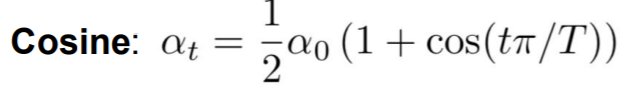

In [7]:
from torch.optim.lr_scheduler import _LRScheduler
import math
# https://github.com/pytorch/pytorch/issues/17913
class LegacyCosineAnnealingLR(_LRScheduler):
    r"""Set the learning rate of each parameter group using a cosine annealing
    schedule, where :math:`\eta_{max}` is set to the initial lr and
    :math:`T_{cur}` is the number of epochs since the last restart in SGDR:

    .. math::

        \eta_t = \eta_{min} + \frac{1}{2}(\eta_{max} - \eta_{min})(1 +
        \cos(\frac{T_{cur}}{T_{max}}\pi))

    When last_epoch=-1, sets initial lr as lr.

    It has been proposed in
    `SGDR: Stochastic Gradient Descent with Warm Restarts`_. Note that this only
    implements the cosine annealing part of SGDR, and not the restarts.

    Args:
        optimizer (Optimizer): Wrapped optimizer.
        T_max (int): Maximum number of iterations.
        eta_min (float): Minimum learning rate. Default: 0.
        last_epoch (int): The index of last epoch. Default: -1.

    .. _SGDR\: Stochastic Gradient Descent with Warm Restarts:
        https://arxiv.org/abs/1608.03983
    """

    def __init__(self, optimizer, T_max, eta_min=0, last_epoch=-1):
        self.T_max = T_max
        self.eta_min = eta_min
        super(LegacyCosineAnnealingLR, self).__init__(optimizer, last_epoch)

    def get_lr(self):
        return [self.eta_min + (base_lr - self.eta_min) *
                (1 + math.cos(math.pi * self.last_epoch / self.T_max)) / 2
                for base_lr in self.base_lrs]
print('r')

r


In [8]:
seq1 = iaa.Sequential(
    [  
        iaa.SomeOf((0, 3),
            [
                iaa.Rotate((-20, 20),mode=ia.ALL),
                iaa.Fliplr(0.5),
                iaa.OneOf([
                    iaa.GaussianBlur(),iaa.AverageBlur(k=(1, 3)),iaa.MedianBlur(k=(1, 3)),
                ]),
                iaa.OneOf([
                    iaa.Sharpen(alpha=(0, 0.5), lightness=(0.75, 1.5)), # sharpen images
                    iaa.Emboss(alpha=(0, 0.3), strength=(0, 2.0))
                    ]),
                iaa.OneOf([
                    iaa.Multiply((0.5, 1.5), per_channel=0.5),
                    iaa.BlendAlphaFrequencyNoise(
                        exponent=(-4, 0),
                        foreground=iaa.Multiply((0.5, 1.5), per_channel=True),
                        background=iaa.LinearContrast((0.5, 2.0))
                    ),
                    iaa.Add((-10, 10), per_channel=0.5), # change brightness of images (by -10 to 10 of original value)
                    iaa.AddToHueAndSaturation((-20, 20)), # change hue and saturation
                    iaa.LinearContrast((0.5, 2.0), per_channel=0.5), # improve or worsen the contrast
                    iaa.Grayscale(alpha=(0.0, 1.0)),
                ]), 
            ],
            random_order=True
        )
    ],
    random_order=True)
print('r')


r


In [17]:
def set_datasets(dir_path, remove_list):
    paths = glob(dir_path)
    for path in remove_list:
        paths.remove(path)
    train_paths, test_paths = train_test_split(paths, test_size=0.2, random_state=2018)
    train_paths, vaild_paths = train_test_split(train_paths, test_size=0.2, random_state=2018)
    transform = torchvision.transforms.Compose([ 
                                            transforms.ToTensor(),
                                            transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])])
    train_set = student_dataset(train_paths, augmentations=seq1, transform=transform)
    vaildtion_set = student_dataset(vaild_paths, transform=transform)
    test_set = student_dataset(test_paths, transform=transform)
    datasets = {
                    'train': train_set,
                    'val': vaildtion_set, 
                    'test': test_set}
    
    return datasets, paths


def set_dataloaders(datasets, BS=16):
    train_loader = DataLoader(datasets['train'], batch_size=BS, shuffle=True, num_workers=8)
    vaildtion_loader = DataLoader(datasets['val'], batch_size=BS, shuffle=True, num_workers=8)
    test_loader = DataLoader(datasets['test'], batch_size=BS, shuffle=True, num_workers=8)
    dataloaders = {
                    'train': train_loader,
                    'val': vaildtion_loader, 
                    'test': test_loader}
    return dataloaders
print('r')

r


In [18]:
datasets, paths = set_datasets(dir_path, remove_list)  
dataloaders = set_dataloaders(datasets, BS=16)
print('r')

r


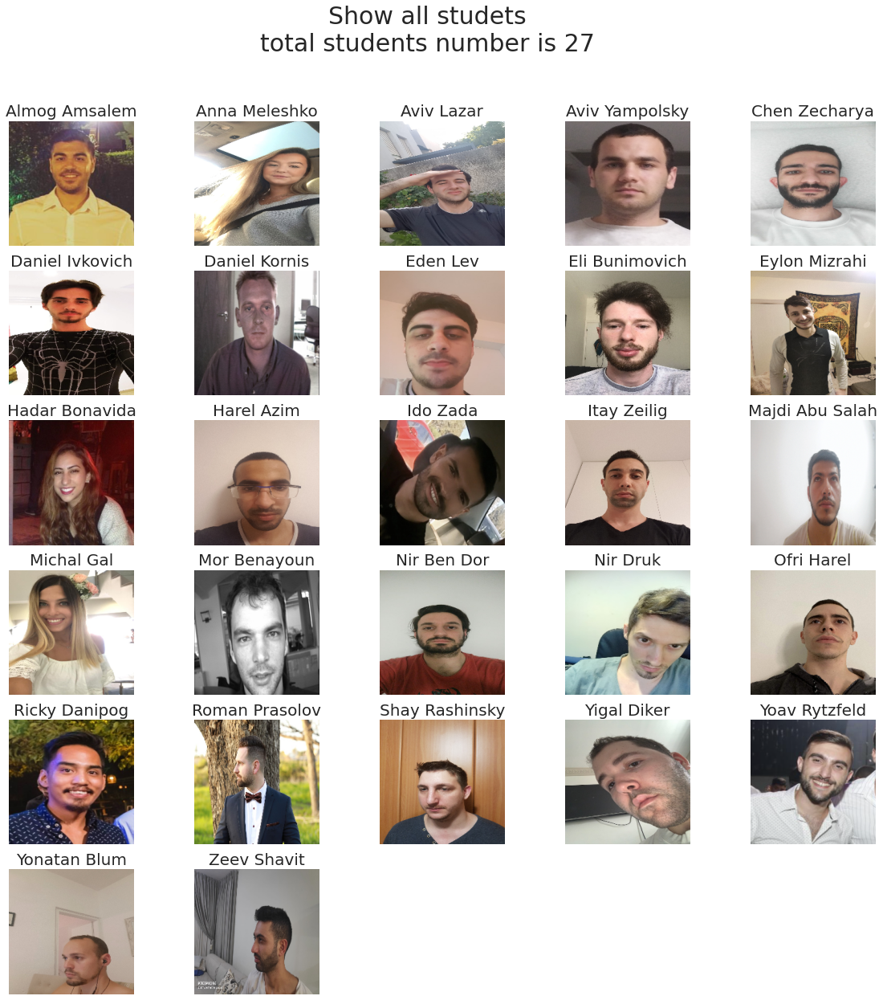

r


In [42]:
show_all(paths)
print('r')

In [11]:
def norm(img):
    img -=img.min()
    img/=img.max()
    return img
print('r')

r


# show faces after augmentation

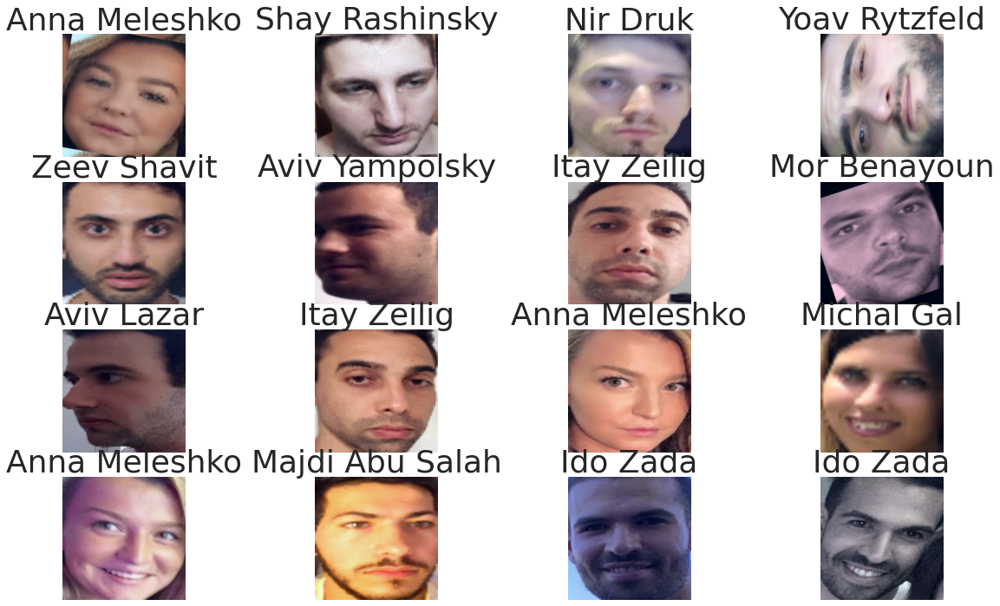

r


In [49]:

names = datasets['train'].names
batch = iter(dataloaders['train'])
img, label, _ = next(batch)
img = img.numpy()

plt.figure(figsize=[20, 12])
for i, (row, t) in enumerate(zip(img, label)):
    plt.subplot(4, 4, i+1)
    if row.shape[0] == 3:
        im = row.transpose(1, 2, 0)
    else:
        im = row.reshape((row.shape[1],row.shape[2])) 
    plt.imshow(norm(im))
    plt.axis('off')
    plt.title(names[t.item()])
plt.show()
print('r')

In [12]:
def optimizers(model, option, lr=0.001, wd=0): 
    optimizer = {
                    'sgd': optim.SGD(model.parameters(), lr=lr, momentum=0.9),
                    'adam': optim.Adam(model.parameters(), lr=lr, weight_decay=wd),
                    'radam': optim1.RAdam(model.parameters(),lr=lr, weight_decay=wd)}
    
    return optimizer[option]
    

def evaluate (y_pred, targets):    
    prediction  = torch.max(y_pred.data, dim=1)[1]
    corrects = 0.0
    for t, y in zip(targets, prediction):
        if t == y:
            corrects += 1.0
    return corrects

def visualization1(model_statics, fgs=[5, 5], rows=1, cols=3):
    plt.figure(figsize=fgs)
    for i, parse in enumerate(['acc', 'loss', 'lr']):

        if parse == 'lr':
            plt.subplot(rows, cols, i+1)
            plt.plot(np.array(model_statics['train'][parse]))
            plt.title('learning range', fontsize=40)
            plt.legend(['lr'])
        else:
            plt.subplot(rows, cols, i+1)
            plt.plot(np.array(model_statics['train'][parse]))
            plt.plot(np.array(model_statics['val'][parse]))
            if parse == 'acc':
                tit = 'accuracy'
            else: 
                tit = parse
            plt.title(tit, fontsize=40)
            plt.legend(['Train','Validation'])

    plt.show()
print('r')

r


In [27]:
import copy
def train_loop(model, loss_function, optimizer, dataloaders, num_epochs=20):
    model_estimation_parameters = {
                                    'train': {
                                            'loss': [],
                                            'acc': [],
                                            'lr': []},
                                    'val': {
                                            'loss': [],
                                            'acc': []}}
    scheduler = LegacyCosineAnnealingLR(optimizer, T_max= num_epochs)
    scheduler.eta_min = 0.00004
    criterion = loss_function
    criterion.to(device)
    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0
    try:
        for epoch in tqdm(range(num_epochs)):
            print(f'Epoch {epoch + 1}/{num_epochs}')
            print('-' * 10)
            for phase in ['train', 'val']:
                if phase == 'train':
                    model.train()  
                else:
                    model.eval()   
                running_loss, running_accuracy, smaples = 0.0, 0.0, 0
                for data, labels, _ in dataloaders[phase]:
                    data, labels = data.to(device), labels.to(device)
                    smaples += labels.size(0)
                    optimizer.zero_grad()
                    with torch.set_grad_enabled(phase == 'train'):
                        outputs = model(data)
                        loss = criterion(outputs, labels)
                        if phase == 'train':
                            loss.backward()
                            optimizer.step()
                        running_loss += loss.item()
                        running_accuracy += evaluate(outputs, labels)

                if phase == 'train':
                    model_estimation_parameters['train']['lr'].append(scheduler.get_lr()[0])
                    scheduler.step()
                epoch_loss = running_loss / smaples
                epoch_acc = running_accuracy / smaples
                model_estimation_parameters[phase]['loss'].append(epoch_loss)
                model_estimation_parameters[phase]['acc'].append(epoch_acc)
                print('{} Loss: {:.4f} Acc: {:.4f}'.format(
                    phase, epoch_loss, epoch_acc))

                # deep copy the model
                if phase == 'val' and epoch_acc > best_acc:
                    best_acc = epoch_acc
                    best_model_wts = copy.deepcopy(model.state_dict())
    except:
        torch.cuda.empty_cache()

    print(f'Best val Acc: {best_acc}')
    # load best model weights
    model.load_state_dict(best_model_wts)
    return model, model_estimation_parameters

print('r')

r


In [39]:
def print_result(classifier, rows=2, cols=5, samples=10):
    print('\n', '_'*20)
    print(f'Examples of {samples} correct examples and {samples} wrongs examples')
    for parse in ['correct', 'wrong']:
        subplot_index = 1
        indexes = np.random.choice(len(classifier[parse]),
                                   samples,  replace=False)
        plt.figure(figsize=(40, 10))
        for index in indexes:
            plt.subplot(rows, cols, subplot_index)
            img = classifier[parse][index][1]
            plt.imshow(img)
            plt.title(classifier[parse][index][0], fontsize=30)
            plt.axis('off')
            subplot_index+=1
            if parse == 'correct':
                plt.suptitle('True Positive\n\n', fontsize=40)
            else:
                plt.suptitle('False Negative\n\n', fontsize=40)
        plt.show()
        
def test(model, test_dataloader, names, show_confusion_matrix=False, statistics=True):
    model.eval()
    classifier = {
                    'correct': [],
                    'wrong': []
        }
    prediction_list, label_list = [], []
    try:
        for data , labels, paths in tqdm(test_dataloader):
            data , labels = data.to(device), labels.to(device), 
            output = model(data)
            prediction  = torch.max(output.data, dim=1)[1]
            for i, (ac, pr) in enumerate(zip(labels, prediction)):
                pred_index = pr.item()
                label_index = ac.item()
                if pred_index <= 27:
                    prediction_list.append(pred_index)
                    label_list.append(label_index)
                    pr_name = names[pred_index]
                    img = plt.imread(paths[i])
                    img = cv2.resize(img, (224, 224))
                    # img = data[i]
                    if ac == pr:
                        classifier['correct'].append((f'model correct predicted:\n {pr_name}', img))
                    else:
                        ac_name = names[label_index]
                        classifier['wrong'].append((f'model wrong predicted:\n {pr_name}\nActual person is: {ac_name}', img))
        if statistics:
            corrects = len(classifier['correct'])
            wrongs = len(classifier['wrong'])
            tot =  corrects + wrongs
            print(f'The model test on {tot}.')
            print(f'The model correct classification {corrects} samples')
            print(f'The model wrong classification {wrongs} samples.')
            print(f'Acccuracy on test {int((corrects/tot)*100)} %')
            print_result(classifier, 1, 4, 4)

        if show_confusion_matrix:
            cm = confusion_matrix(label_list, prediction_list, labels=[i for i in range (len(names))]).astype('uint8')
            df_cm = pd.DataFrame(cm, index = [i for i in names],
                            columns = [i for i in names])
            plt.figure(figsize = (60,60))
            sn.set(font_scale=3) # for label size
            sn.heatmap(df_cm, annot=True, annot_kws={"size": 16},cmap='BuPu',fmt='g')
            plt.show()
    except:
        torch.cuda.empty_cache()
print('r')

r


# VGG16 model 


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:18: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`


Epoch 1/20
----------
train Loss: 0.2200 Acc: 0.0340
val Loss: 0.2291 Acc: 0.0562
Epoch 2/20
----------
train Loss: 0.2210 Acc: 0.0907
val Loss: 0.2402 Acc: 0.0674
Epoch 3/20
----------
train Loss: 0.2074 Acc: 0.0963
val Loss: 0.2243 Acc: 0.0674
Epoch 4/20
----------
train Loss: 0.1893 Acc: 0.1331
val Loss: 0.2253 Acc: 0.1461
Epoch 5/20
----------
train Loss: 0.1828 Acc: 0.1926
val Loss: 0.2390 Acc: 0.1573
Epoch 6/20
----------
train Loss: 0.1837 Acc: 0.2068
val Loss: 0.2028 Acc: 0.2360
Epoch 7/20
----------
train Loss: 0.1552 Acc: 0.2776
val Loss: 0.1737 Acc: 0.2809
Epoch 8/20
----------
train Loss: 0.1427 Acc: 0.3371
val Loss: 0.2230 Acc: 0.1685
Epoch 9/20
----------
train Loss: 0.1336 Acc: 0.3909
val Loss: 0.1512 Acc: 0.4157
Epoch 10/20
----------
train Loss: 0.1432 Acc: 0.4193
val Loss: 0.1356 Acc: 0.4382
Epoch 11/20
----------
train Loss: 0.1104 Acc: 0.5212
val Loss: 0.1423 Acc: 0.4607
Epoch 12/20
----------
train Loss: 0.0970 Acc: 0.5949
val Loss: 0.1356 Acc: 0.5056
Epoch 13/20
-

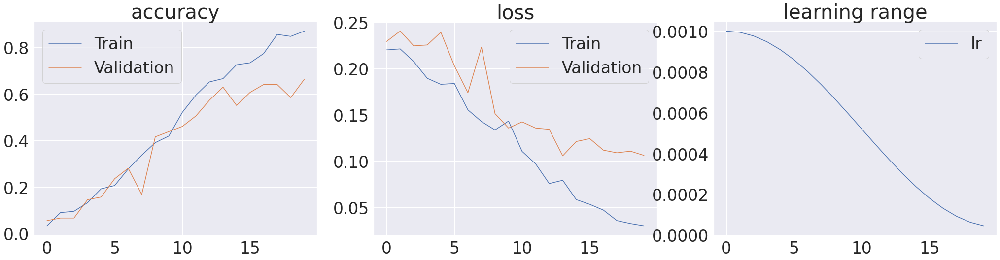

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:30: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`



The model test on 111.
The model correct classification 75 samples
The model wrong classification 36 samples.
Acccuracy on test 67 %

 ____________________
Examples of 4 correct examples and 4 wrongs examples


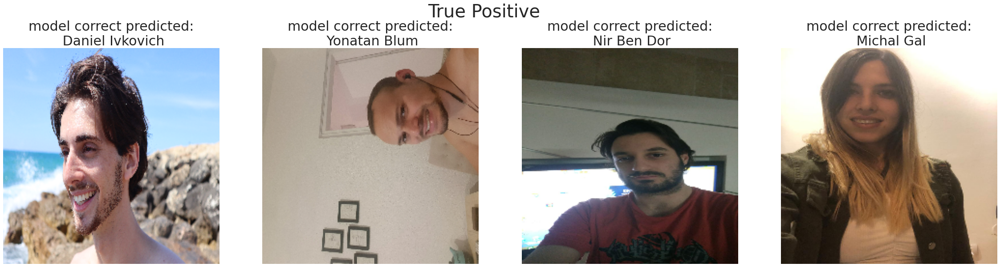

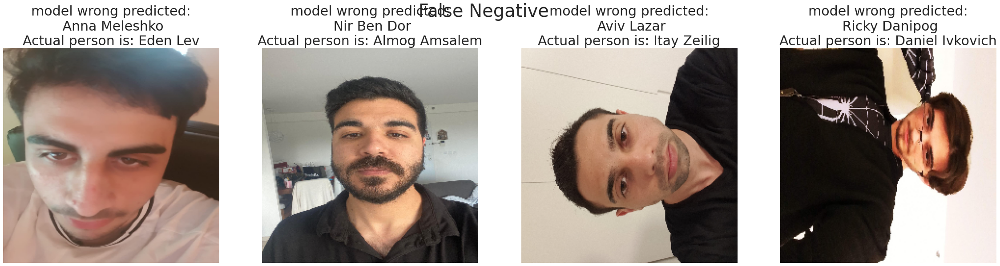

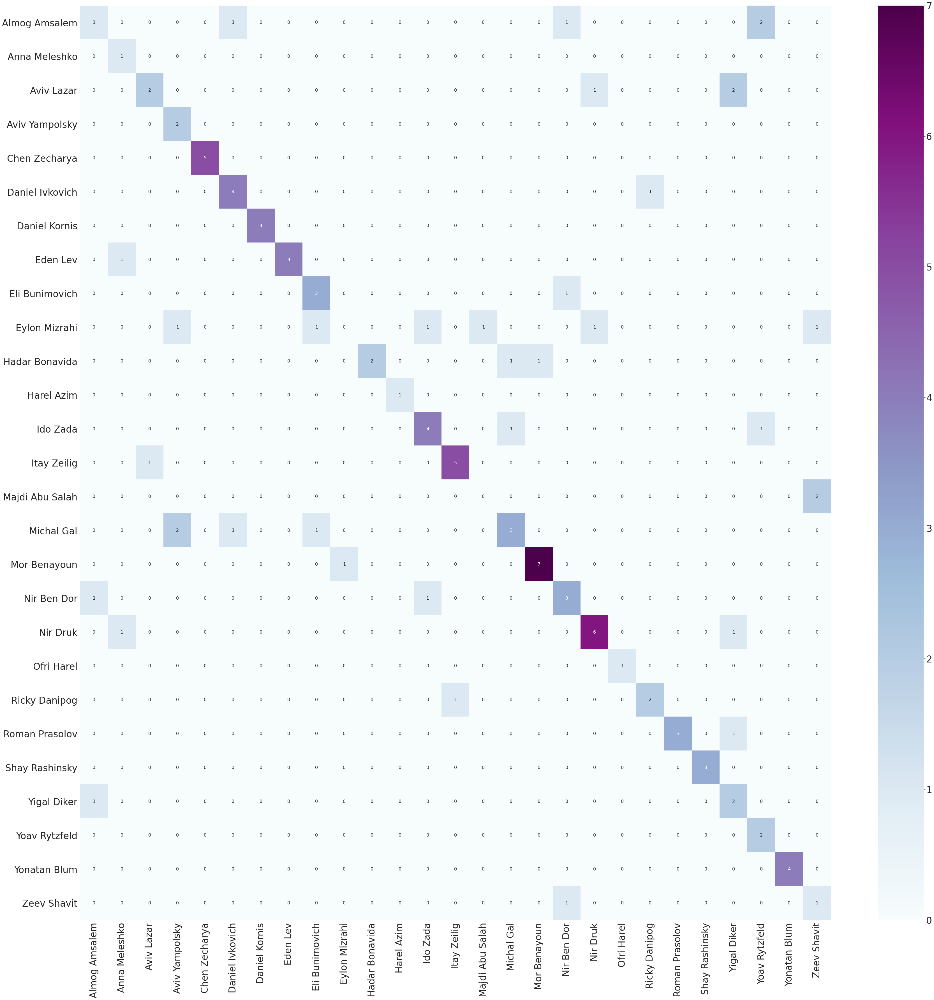

In [47]:
vgg16 = VGG16()
vgg16.to(device)
radam = optimizers(vgg16, 'radam', lr=1e-3, wd=0)
num_epochs = 20
scheduler = LegacyCosineAnnealingLR(radam, T_max= num_epochs)

loss_funaction = nn.CrossEntropyLoss()
vgg16, dic = train_loop(vgg16,loss_funaction, radam, dataloaders, num_epochs)
visualization1(dic, [35, 8])
model_save_name = 'vgg16_model1.pt'
models_path['vgg16'] = models_path['vgg16'] + model_save_name
torch.save(vgg16.state_dict(), models_path['vgg16'])

names = datasets['test'].names
test(vgg16, dataloaders['test'], names,
    show_confusion_matrix=True, statistics=True)


# Shufflenet model
[shufflenet an extremely efficient convolutional neural network for mobile devices](https://medium.com/syncedreview/shufflenet-an-extremely-efficient-convolutional-neural-network-for-mobile-devices-72c6f5b01651)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:18: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`


Epoch 1/20
----------
train Loss: 0.5263 Acc: 0.0028
val Loss: 0.4912 Acc: 0.0112
Epoch 2/20
----------
train Loss: 0.3792 Acc: 0.0850
val Loss: 0.3104 Acc: 0.2022
Epoch 3/20
----------
train Loss: 0.2355 Acc: 0.3569
val Loss: 0.1979 Acc: 0.4157
Epoch 4/20
----------
train Loss: 0.1279 Acc: 0.6204
val Loss: 0.1258 Acc: 0.5506
Epoch 5/20
----------
train Loss: 0.0823 Acc: 0.7649
val Loss: 0.1007 Acc: 0.6517
Epoch 6/20
----------
train Loss: 0.0534 Acc: 0.8215
val Loss: 0.0738 Acc: 0.7753
Epoch 7/20
----------
train Loss: 0.0448 Acc: 0.8754
val Loss: 0.0627 Acc: 0.7978
Epoch 8/20
----------
train Loss: 0.0280 Acc: 0.9235
val Loss: 0.0618 Acc: 0.7978
Epoch 9/20
----------
train Loss: 0.0279 Acc: 0.9348
val Loss: 0.0687 Acc: 0.7528
Epoch 10/20
----------
train Loss: 0.0237 Acc: 0.9575
val Loss: 0.0577 Acc: 0.7978
Epoch 11/20
----------
train Loss: 0.0195 Acc: 0.9405
val Loss: 0.0588 Acc: 0.7978
Epoch 12/20
----------
train Loss: 0.0172 Acc: 0.9745
val Loss: 0.0506 Acc: 0.8090
Epoch 13/20
-

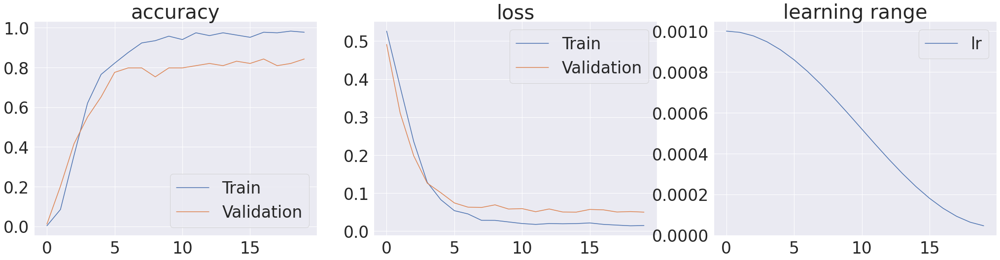

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:30: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`



The model test on 111.
The model correct classification 95 samples
The model wrong classification 16 samples.
Acccuracy on test 85 %

 ____________________
Examples of 4 correct examples and 4 wrongs examples


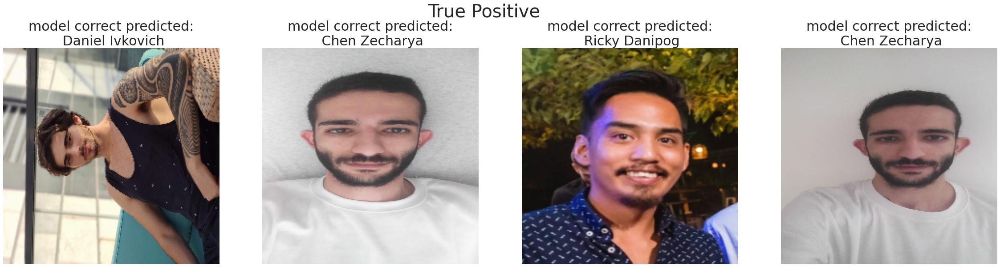

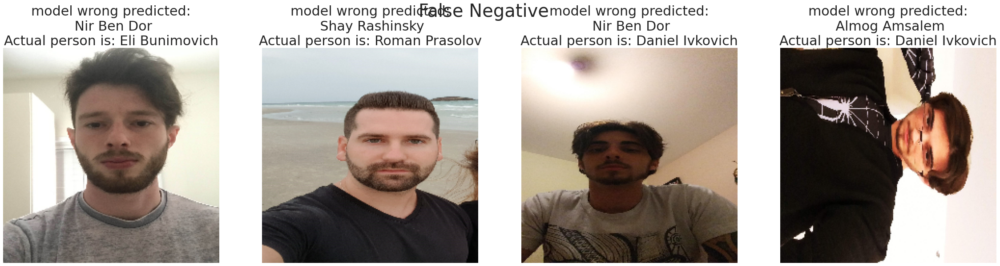

r


In [48]:
shufflenet = models.shufflenet_v2_x1_0(pretrained=True)
shufflenet.fc.out_features=28
shufflenet.to(device)
radam = optimizers(shufflenet, 'radam', lr=1e-3, wd=1e-5)
loss_funaction = nn.CrossEntropyLoss()
epochs = 20
shufflenet, dic = train_loop(shufflenet, loss_funaction, radam, dataloaders, epochs)
visualization1(dic, [35, 8])
model_save_name = 'shufflenet_model.pt'
models_path['shufflenet'] = models_path['shufflenet'] + model_save_name
torch.save(shufflenet.state_dict(), models_path['shufflenet'])

names = datasets['test'].names
test(shufflenet, dataloaders['test'], names,
    show_confusion_matrix=False, statistics=True)
print('r')

# Resnet50
[understanding and implementing architectures of resnet](https://medium.com/@14prakash/understanding-and-implementing-architectures-of-resnet-and-resnext-for-state-of-the-art-image-cf51669e1624)

Downloading: "https://download.pytorch.org/models/resnet50-19c8e357.pth" to /root/.cache/torch/checkpoints/resnet50-19c8e357.pth


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:18: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`


Epoch 1/20
----------
train Loss: 0.4771 Acc: 0.0368
val Loss: 0.2481 Acc: 0.3258
Epoch 2/20
----------
train Loss: 0.1225 Acc: 0.6714
val Loss: 0.0880 Acc: 0.7416
Epoch 3/20
----------
train Loss: 0.0343 Acc: 0.9037
val Loss: 0.0595 Acc: 0.8315
Epoch 4/20
----------
train Loss: 0.0324 Acc: 0.9178
val Loss: 0.0487 Acc: 0.8764
Epoch 5/20
----------
train Loss: 0.0231 Acc: 0.9348
val Loss: 0.0519 Acc: 0.8202
Epoch 6/20
----------
train Loss: 0.0220 Acc: 0.9575
val Loss: 0.0522 Acc: 0.8427
Epoch 7/20
----------
train Loss: 0.0185 Acc: 0.9773
val Loss: 0.0529 Acc: 0.8876
Epoch 8/20
----------
train Loss: 0.0214 Acc: 0.9688
val Loss: 0.0558 Acc: 0.8539
Epoch 9/20
----------
train Loss: 0.0181 Acc: 0.9603
val Loss: 0.0443 Acc: 0.8989
Epoch 10/20
----------
train Loss: 0.0172 Acc: 0.9688
val Loss: 0.0572 Acc: 0.8876
Epoch 11/20
----------
train Loss: 0.0129 Acc: 0.9773
val Loss: 0.0388 Acc: 0.9101
Epoch 12/20
----------
train Loss: 0.0101 Acc: 0.9802
val Loss: 0.0598 Acc: 0.8764
Epoch 13/20
-

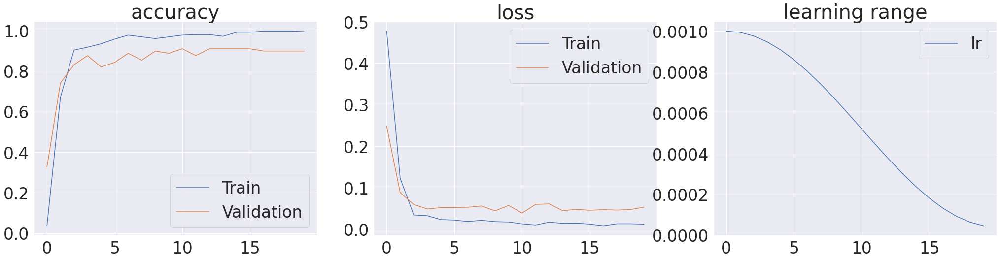

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:30: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`



The model test on 111.
The model correct classification 103 samples
The model wrong classification 8 samples.
Acccuracy on test 92 %

 ____________________
Examples of 4 correct examples and 4 wrongs examples


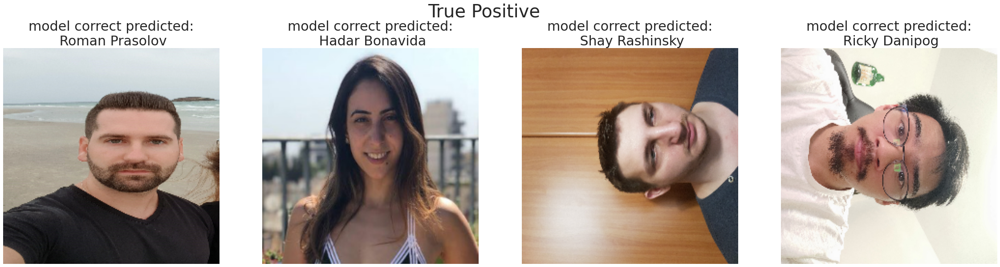

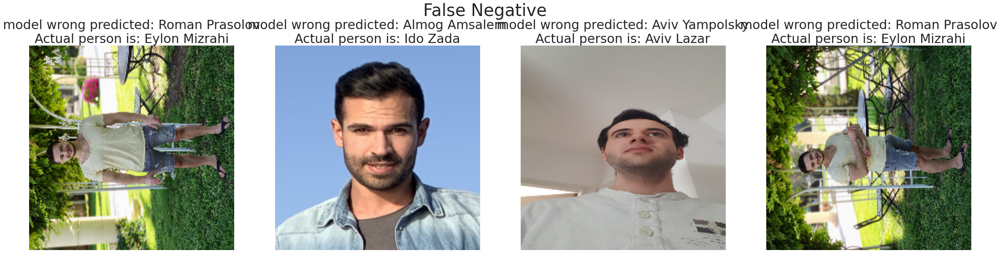

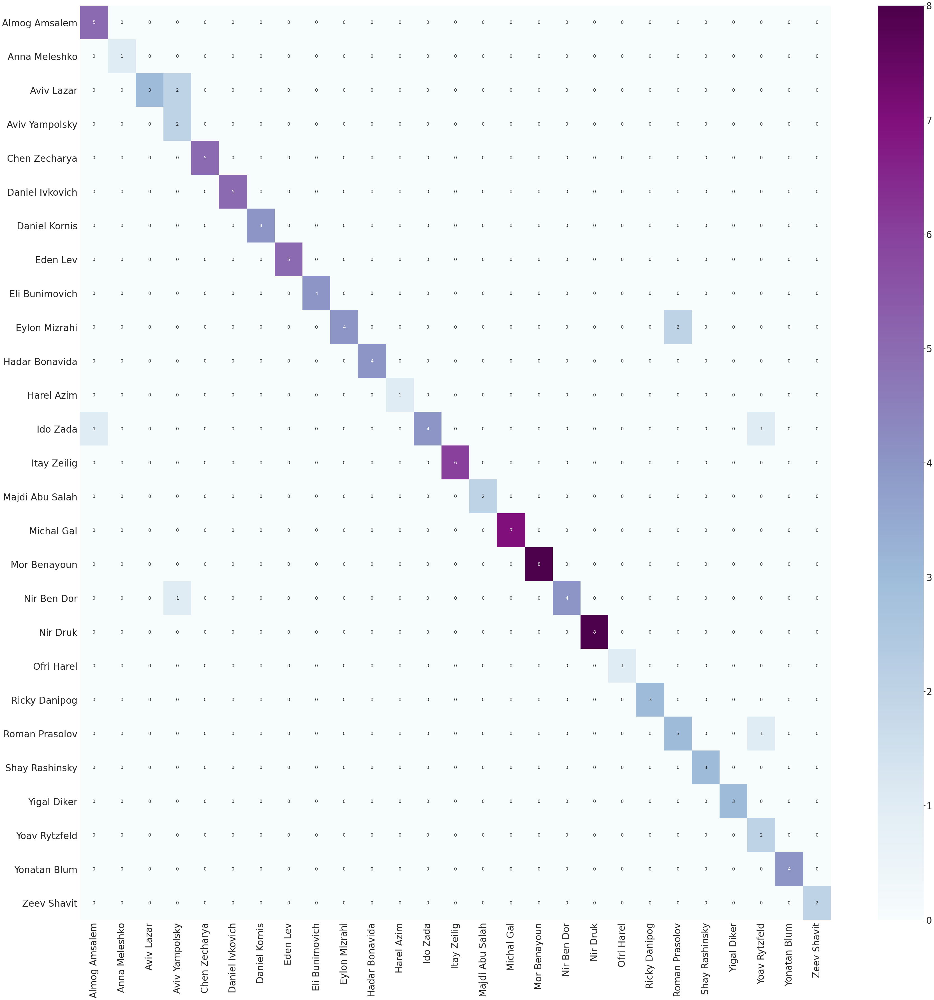

r


In [25]:
resnet50 = models.resnet50(pretrained=True)
resnet50.fc.out_features=28
resnet50.to(device)
radam = optimizers(resnet50, 'radam', lr=1e-3, wd=1e-5)
loss_funaction = nn.CrossEntropyLoss()
resnet50, dic = train_loop(resnet50, loss_funaction, radam, dataloaders, 20)
visualization1(dic, [35, 8])
model_save_name = 'resnet50_model.pt'
models_path['resnet50'] = models_path['resnet50'] + model_save_name
torch.save(resnet50.state_dict(), models_path['resnet50'])

names = datasets['test'].names
test(resnet50, dataloaders['test'], names,
    show_confusion_matrix=True, statistics=True)
print('r')

# VGG19
[paper review of vggnet](https://medium.com/coinmonks/paper-review-of-vggnet-1st-runner-up-of-ilsvlc-2014-image-classification-d02355543a11)

Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/checkpoints/vgg19-dcbb9e9d.pth


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:18: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`


Epoch 1/20
----------
train Loss: 0.3832 Acc: 0.0397
val Loss: 0.2785 Acc: 0.0787
Epoch 2/20
----------
train Loss: 0.2450 Acc: 0.0652
val Loss: 0.2259 Acc: 0.0562
Epoch 3/20
----------
train Loss: 0.1831 Acc: 0.2351
val Loss: 0.1911 Acc: 0.1236
Epoch 4/20
----------
train Loss: 0.1411 Acc: 0.4193
val Loss: 0.3563 Acc: 0.2809
Epoch 5/20
----------
train Loss: 0.1680 Acc: 0.3484
val Loss: 0.1714 Acc: 0.3933
Epoch 6/20
----------
train Loss: 0.1299 Acc: 0.4703
val Loss: 0.1695 Acc: 0.3933
Epoch 7/20
----------
train Loss: 0.0969 Acc: 0.5411
val Loss: 0.1308 Acc: 0.4831
Epoch 8/20
----------
train Loss: 0.0753 Acc: 0.6714
val Loss: 0.1317 Acc: 0.5730
Epoch 9/20
----------
train Loss: 0.0632 Acc: 0.7025
val Loss: 0.0745 Acc: 0.7079
Epoch 10/20
----------
train Loss: 0.0485 Acc: 0.7847
val Loss: 0.0825 Acc: 0.7978
Epoch 11/20
----------
train Loss: 0.0307 Acc: 0.8414
val Loss: 0.0781 Acc: 0.7865
Epoch 12/20
----------
train Loss: 0.0362 Acc: 0.8697
val Loss: 0.0935 Acc: 0.7865
Epoch 13/20
-

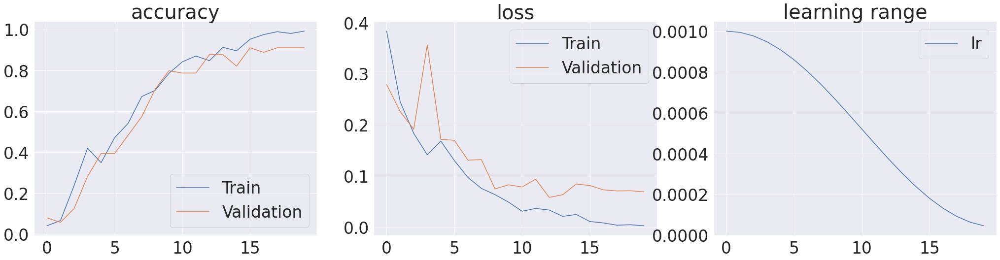

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:30: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`



The model test on 111.
The model correct classification 97 samples
The model wrong classification 14 samples.
Acccuracy on test 87 %

 ____________________
Examples of 4 correct examples and 4 wrongs examples


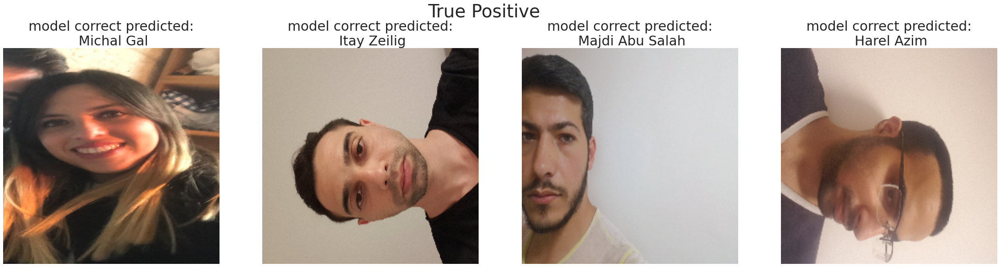

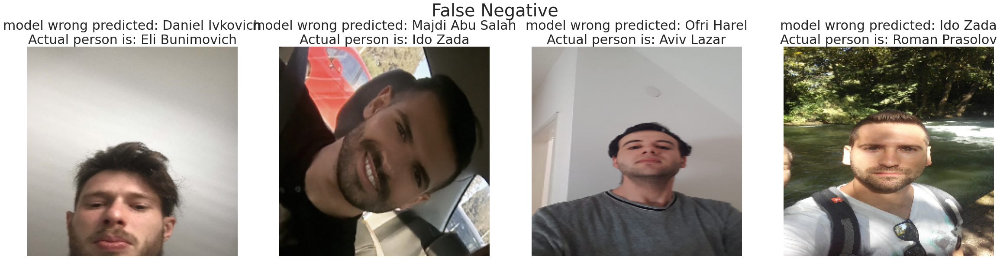

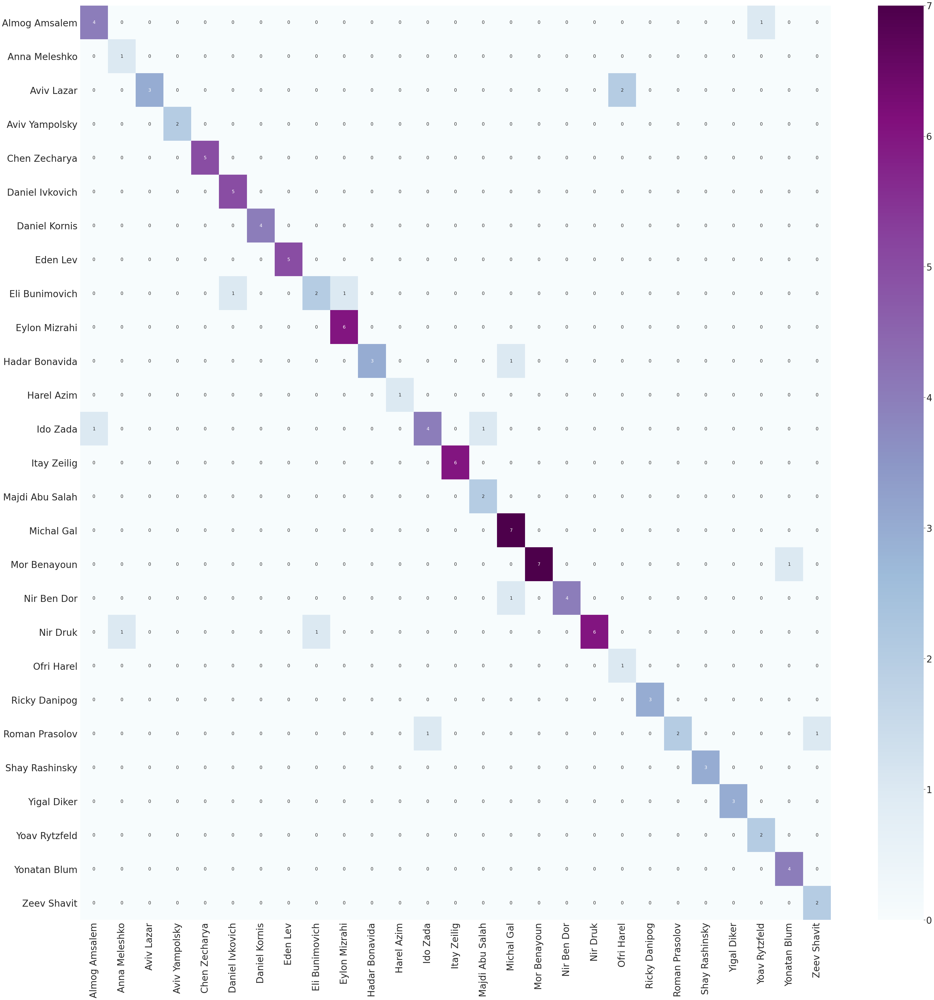

r


In [26]:
vgg19 = models.vgg19(pretrained=True)
vgg19.classifier[6].out_features = 28
vgg19.to(device)
radam = optimizers(vgg19, 'radam', lr=1e-3, wd=1e-5)
loss_funaction = nn.CrossEntropyLoss()
vgg19, dic = train_loop(vgg19, loss_funaction, radam, dataloaders, 20)
visualization1(dic, [35, 8])
model_save_name = 'vgg19_model.pt'
models_path['vgg19'] = models_path['vgg19'] + model_save_name
torch.save(vgg19.state_dict(), models_path['vgg19'])

names = datasets['test'].names
test(vgg19, dataloaders['test'], names,
     show_confusion_matrix=True, statistics=True)
print('r')

# Mobilenet
[why mobilenet and its variants](https://medium.com/@yu4u/why-mobilenet-and-its-variants-e-g-shufflenet-are-fast-1c7048b9618d)

Downloading: "https://download.pytorch.org/models/mobilenet_v2-b0353104.pth" to /root/.cache/torch/checkpoints/mobilenet_v2-b0353104.pth


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:18: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`


Epoch 1/20
----------
train Loss: 0.5937 Acc: 0.0085
val Loss: 0.4850 Acc: 0.0562
Epoch 2/20
----------
train Loss: 0.2827 Acc: 0.3003
val Loss: 0.1648 Acc: 0.5169
Epoch 3/20
----------
train Loss: 0.0931 Acc: 0.7507
val Loss: 0.0632 Acc: 0.7978
Epoch 4/20
----------
train Loss: 0.0458 Acc: 0.8867
val Loss: 0.0477 Acc: 0.8315
Epoch 5/20
----------
train Loss: 0.0335 Acc: 0.9207
val Loss: 0.0455 Acc: 0.8539
Epoch 6/20
----------
train Loss: 0.0290 Acc: 0.9348
val Loss: 0.0452 Acc: 0.8652
Epoch 7/20
----------
train Loss: 0.0204 Acc: 0.9518
val Loss: 0.0382 Acc: 0.8764
Epoch 8/20
----------
train Loss: 0.0211 Acc: 0.9518
val Loss: 0.0454 Acc: 0.8539
Epoch 9/20
----------
train Loss: 0.0163 Acc: 0.9745
val Loss: 0.0612 Acc: 0.8652
Epoch 10/20
----------
train Loss: 0.0175 Acc: 0.9745
val Loss: 0.0658 Acc: 0.8652
Epoch 11/20
----------
train Loss: 0.0144 Acc: 0.9717
val Loss: 0.0469 Acc: 0.8652
Epoch 12/20
----------
train Loss: 0.0151 Acc: 0.9915
val Loss: 0.0586 Acc: 0.8315
Epoch 13/20
-

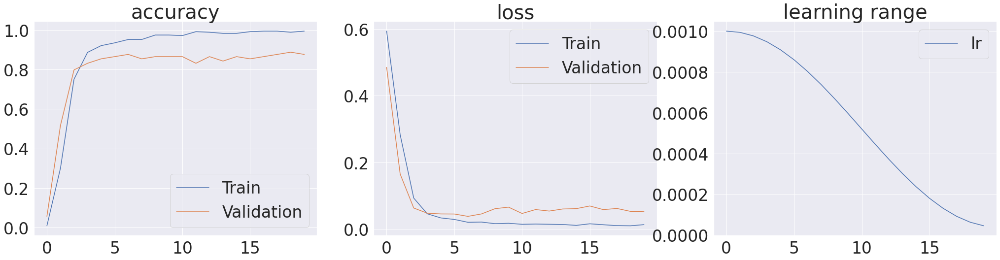

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:30: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`



The model test on 111.
The model correct classification 104 samples
The model wrong classification 7 samples.
Acccuracy on test 93 %

 ____________________
Examples of 4 correct examples and 4 wrongs examples


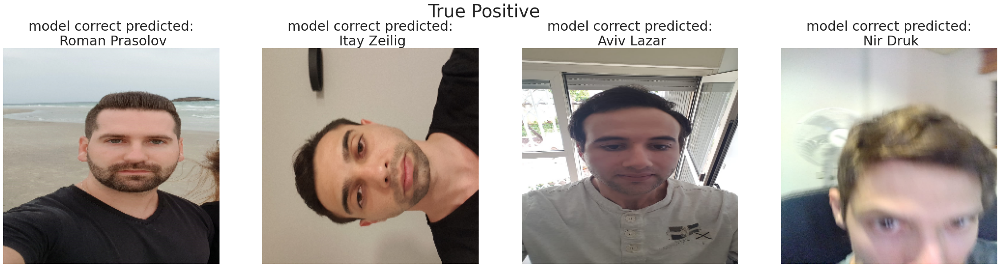

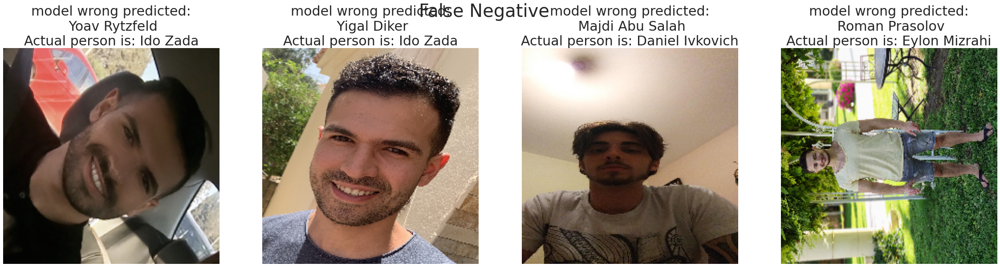

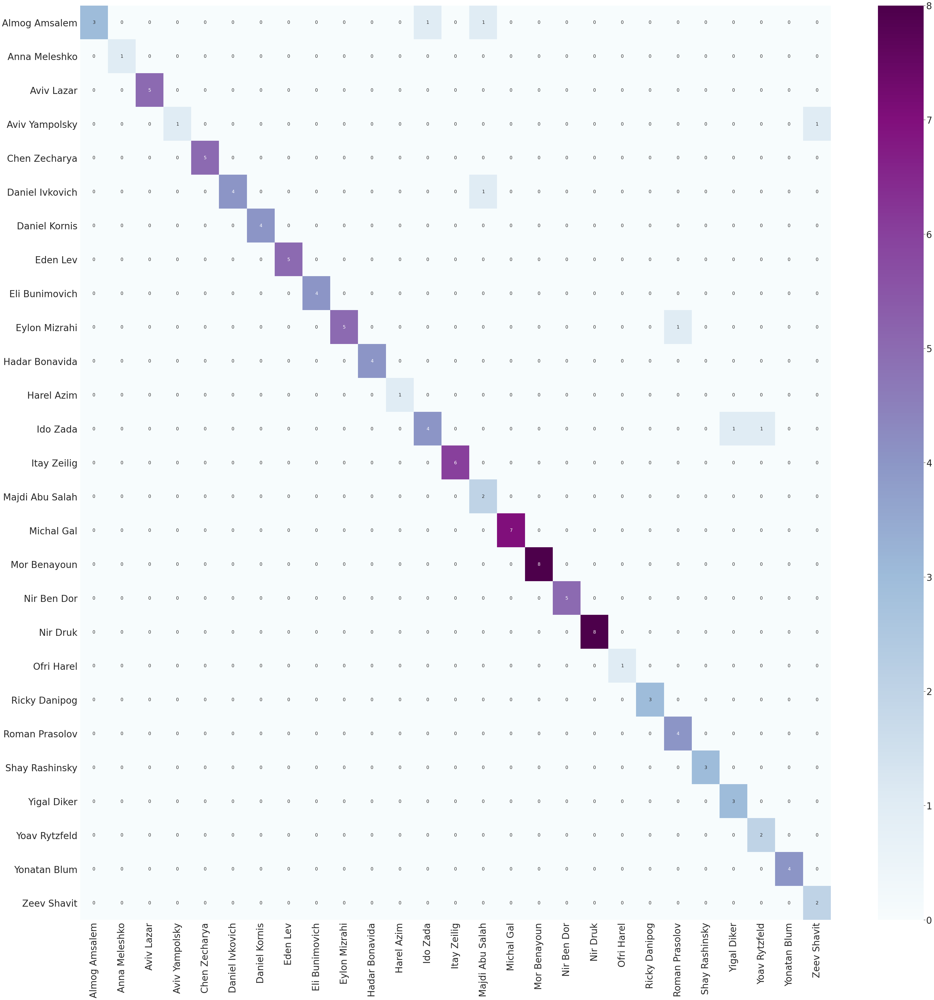

r


In [29]:
mobilenet = models.mobilenet_v2(pretrained=True)
mobilenet.classifier[1].out_features = 28
mobilenet.to(device)
radam = optimizers(mobilenet, 'radam', lr=1e-3, wd=1e-5)
loss_funaction = nn.CrossEntropyLoss()
mobilenet, dic = train_loop(mobilenet, loss_funaction, radam, dataloaders, 20)
visualization1(dic, [35, 8])
model_save_name = 'mobilenet_model.pt'
models_path['mobilenet'] = models_path['mobilenet'] + model_save_name
torch.save(mobilenet.state_dict(), models_path['mobilenet'])

names = datasets['test'].names
test(mobilenet, dataloaders['test'], names,
     show_confusion_matrix=True, statistics=True)
print('r')

# Googlenet

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:18: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`


Epoch 1/20
----------
train Loss: 0.4753 Acc: 0.0000
val Loss: 0.4276 Acc: 0.0112
Epoch 2/20
----------
train Loss: 0.3050 Acc: 0.2181
val Loss: 0.2092 Acc: 0.5169
Epoch 3/20
----------
train Loss: 0.1449 Acc: 0.6232
val Loss: 0.0991 Acc: 0.6854
Epoch 4/20
----------
train Loss: 0.0659 Acc: 0.8442
val Loss: 0.0581 Acc: 0.8090
Epoch 5/20
----------
train Loss: 0.0432 Acc: 0.9093
val Loss: 0.0390 Acc: 0.8764
Epoch 6/20
----------
train Loss: 0.0277 Acc: 0.9462
val Loss: 0.0346 Acc: 0.8876
Epoch 7/20
----------
train Loss: 0.0220 Acc: 0.9745
val Loss: 0.0315 Acc: 0.9101
Epoch 8/20
----------
train Loss: 0.0221 Acc: 0.9830
val Loss: 0.0354 Acc: 0.9101
Epoch 9/20
----------
train Loss: 0.0165 Acc: 0.9802
val Loss: 0.0343 Acc: 0.9101
Epoch 10/20
----------
train Loss: 0.0158 Acc: 0.9915
val Loss: 0.0278 Acc: 0.9326
Epoch 11/20
----------
train Loss: 0.0174 Acc: 0.9887
val Loss: 0.0265 Acc: 0.9213
Epoch 12/20
----------
train Loss: 0.0141 Acc: 0.9943
val Loss: 0.0236 Acc: 0.9213
Epoch 13/20
-

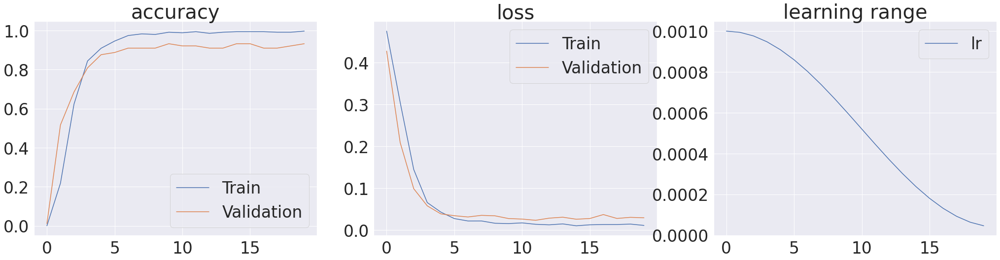

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:30: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`



The model test on 111.
The model correct classification 99 samples
The model wrong classification 12 samples.
Acccuracy on test 89 %

 ____________________
Examples of 4 correct examples and 4 wrongs examples


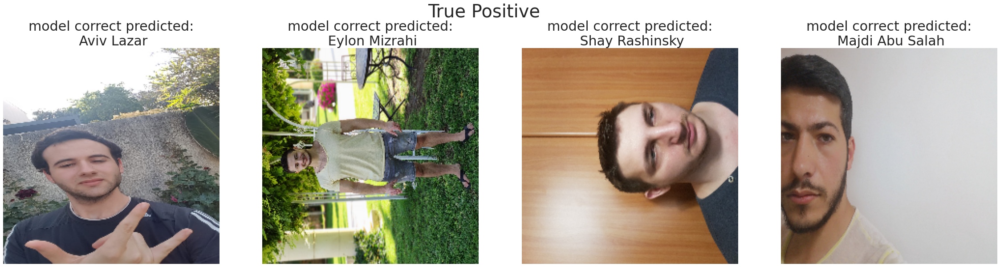

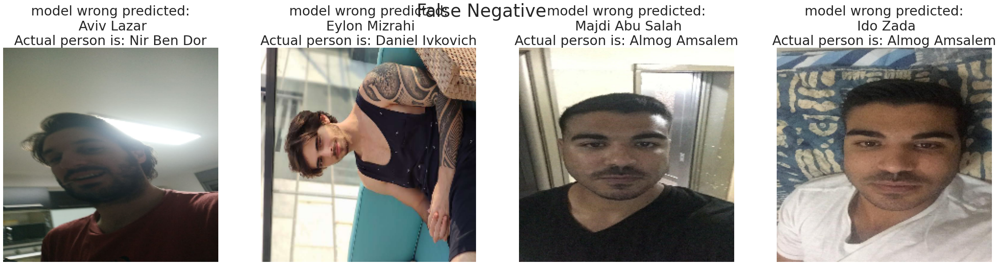

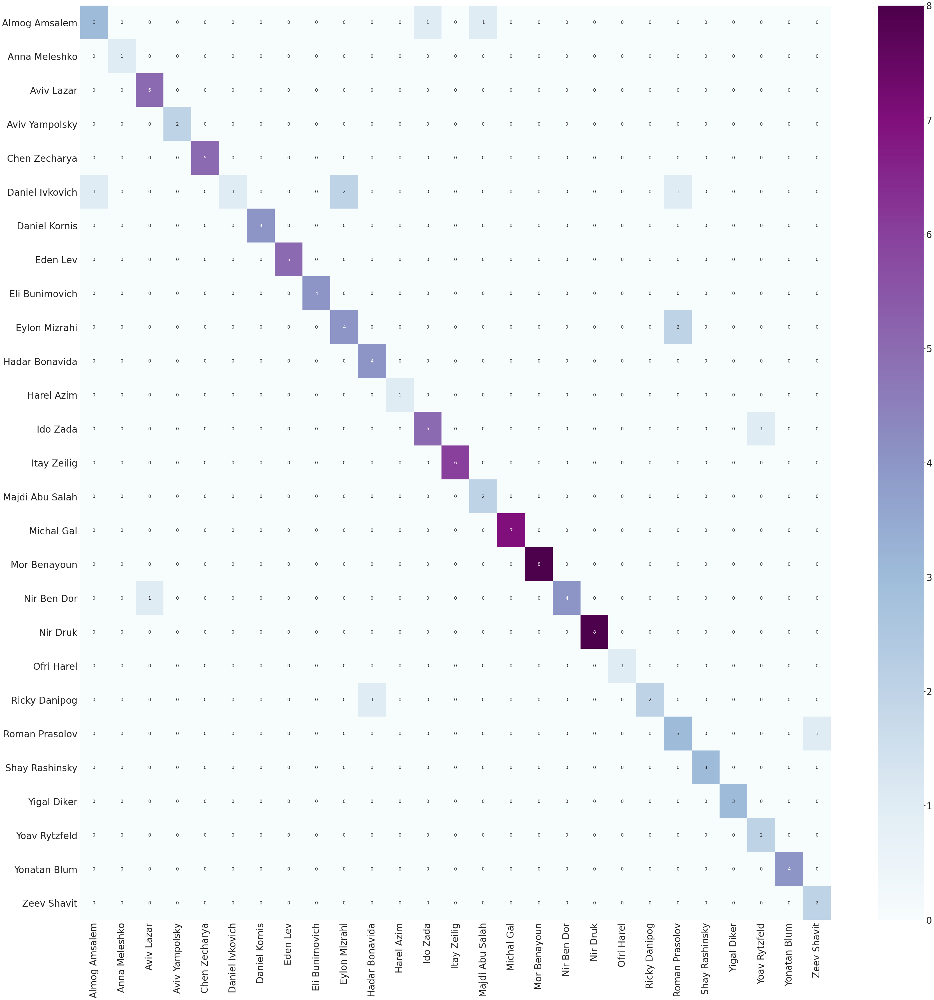

r


In [32]:
googlenet = models.googlenet(pretrained=True)
googlenet.fc.out_features=28
googlenet.to(device)
radam = optimizers(googlenet, 'radam', lr=1e-3, wd=1e-5)
num_epochs = 20
scheduler = LegacyCosineAnnealingLR(radam, T_max= num_epochs)
loss_funaction = nn.CrossEntropyLoss()
googlenet, dic = train_loop(googlenet, loss_funaction, radam, dataloaders, num_epochs)
visualization1(dic, [35, 8])
model_save_name = 'googlenet_model.pt'
models_path['googlenet'] = models_path['googlenet'] + model_save_name
torch.save(googlenet.state_dict(), models_path['googlenet'])

names = datasets['test'].names
test(googlenet, dataloaders['test'], names,
     show_confusion_matrix=True, statistics=True)
print('r')

# Ensemble


In [0]:
class MyEnsemble(nn.Module):
    def __init__(self, model_1, model_2, model_3, model_4, model_5, total_in_features, num_class):
            super(MyEnsemble,self).__init__()
            self.num_class = num_class
            self.total_in_features = total_in_features
            self.model_1 = model_1
            self.model_2 = model_2
            self.model_3 = model_3
            self.model_4 = model_4
            self.model_5 = model_5
            self.fully_connected = self.create_fully_connected()
            
    def create_fully_connected(self):
        return nn.Sequential(
            nn.ReLU(),
            nn.Linear(self.total_in_features, self.num_class)
            )

    def forward(self, x):
        x1 = self.model_1(x.clone())  # clone to make sure x is not changed by inplace methods
        x1 = x1.view(x1.size(0), -1)
        
        x2 = self.model_2(x)
        x2 = x2.view(x2.size(0), -1)
        
        x3 = self.model_3(x)
        x3 = x3.view(x3.size(0), -1)
        
        x4 = self.model_4(x)
        x4 = x4.view(x4.size(0), -1)
        
        x5 = self.model_5(x)
        x5 = x5.view(x5.size(0), -1)
                
        #final
        x = torch.cat((x1, x2, x3, x4, x5), dim=1)
        x = self.fully_connected(x)
        return x


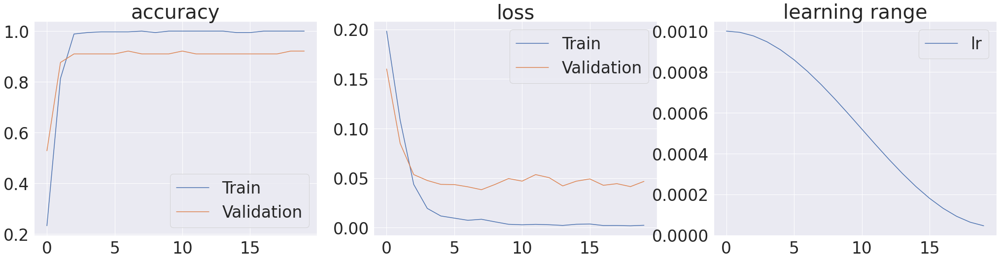

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:30: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`



The model test on 111.
The model correct classification 107 samples
The model wrong classification 4 samples.
Acccuracy on test 96 %

 ____________________
Examples of 4 correct examples and 4 wrongs examples


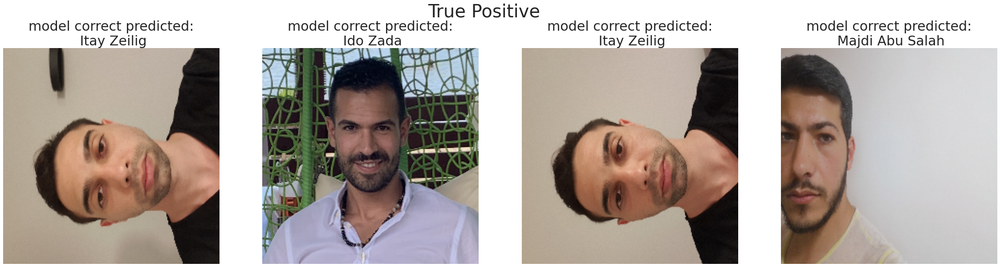

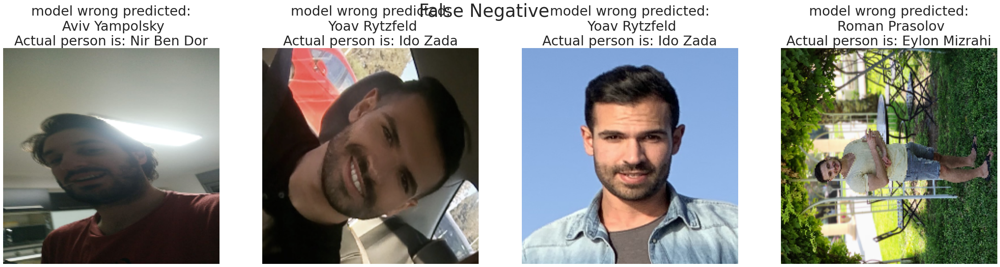

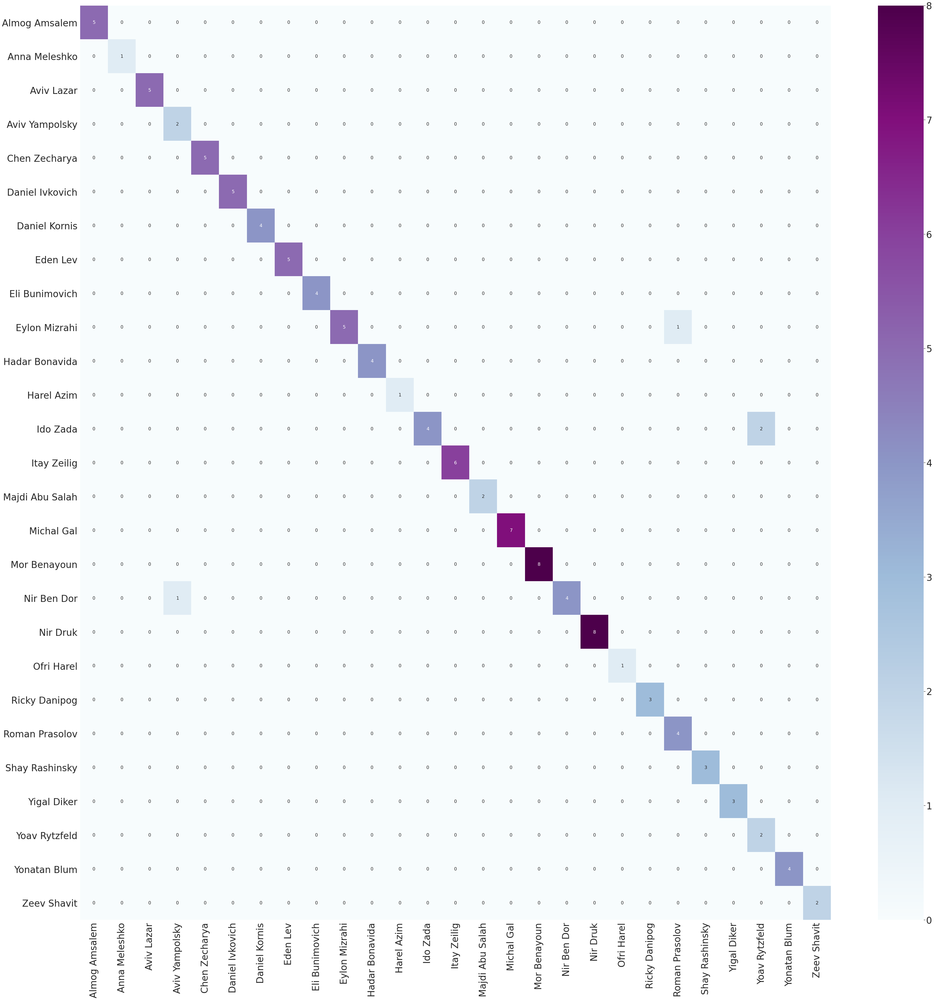

r


In [38]:
total_in_features = 0

shufflenet = models.shufflenet_v2_x1_0(pretrained=True)
shufflenet.fc.out_features = 28
total_in_features += shufflenet.fc.in_features
shufflenet.load_state_dict(torch.load(models_path['shufflenet']))
shufflenet.fc = nn.Identity() 

resnet50 = models.resnet50(pretrained=True)
resnet50.fc.out_features = 28
total_in_features += resnet50.fc.in_features
resnet50.load_state_dict(torch.load(models_path['resnet50']))
resnet50.fc = nn.Identity() 

vgg19 = models.vgg19(pretrained=True)
vgg19.classifier[6].out_features = 28
total_in_features += vgg19.classifier[6].in_features
vgg19.load_state_dict(torch.load(models_path['vgg19']))
vgg19.classifier[6] = nn.Identity() 

mobilenet = models.mobilenet_v2(pretrained=True)
mobilenet.classifier[1].out_features = 28
total_in_features += mobilenet.classifier[1].in_features
mobilenet.load_state_dict(torch.load(models_path['mobilenet']))
mobilenet.classifier[1] = nn.Identity()           

googlenet = models.googlenet(pretrained=True)
googlenet.fc.out_features = 28
total_in_features += googlenet.fc.in_features
googlenet.load_state_dict(torch.load(models_path['googlenet']))
googlenet.fc = nn.Identity()            


models_list = [shufflenet, resnet50, vgg19, mobilenet, googlenet]
for model in models_list:
    for param in model.parameters():
        param.requires_grad_(False)

ensemble = MyEnsemble(shufflenet, resnet50, vgg19, mobilenet, googlenet, total_in_features, 28)
ensemble.to(device)

radam = optimizers(ensemble, 'radam', lr=1e-3, wd=1e-5)
num_epochs = 20
scheduler = LegacyCosineAnnealingLR(radam, T_max= num_epochs)
loss_funaction = nn.CrossEntropyLoss()
ensemble, dic = train_loop(ensemble, loss_funaction, radam, dataloaders, num_epochs)
visualization1(dic, [35, 8])
model_save_name = 'ensemble_model.pt'
models_path['ensemble'] = models_path['ensemble'] + model_save_name
torch.save(ensemble.state_dict(), models_path['ensemble'])

names = datasets['test'].names
test(ensemble, dataloaders['test'], names,
     show_confusion_matrix=True, statistics=True)
print('r')

# Summary:
# Part One
In continuation of the previous exercise, in this exercise, I was required to train different models for a face recognition task. I used tools and functions from the previous exercise, and I also used image augmentation techniques to expand the number of images and make it difficult for the model in the learning process. By running for the first time the model without extract the face I got bad accuracy on the test. For dealing with this problem I used the ___ face detection and face cutting model.
Without the preprocessing, the model would have learned insignificant facial recognition elements, noise and poor performance.
I first implemented the VGG16 model, improving the training results by changing the hyperparameters, until getting ____ for ____.

# Second part - transfer learning

I then used the TORCHVISION trained model library to train five different models. All models in the library can be loaded as pretrained on the imagnet dataset which contains millions of classified images. To fit the models to the assignment requirements, I needed to change the last layer in each model to the output of 1000 (as the number of classes in imgnet) to 27 as the number of students.

Selected models (random selection): shufflenet, resnet50, vgg19, mobilenet, googlenet. 

After training the five models, I combined them into one model(ensemble). 
 their mounting option was tested for one model to improve accuracy. After understanding that to perform the assembly first I must ignore the last layer of each model (basically the prediction), the number of features that the assembly model receives consists of the sum of the out features.

# optimizers:
optimizers that checked:
- SGD + momentum
- ADAM
- RADAM

# Schedulers:
A number of Schedulers were tested to accommodate some learning in training:

- StepLR - which requires a lot of time for good adjusting the scheduler hyperparameters.
- implemented cosine learing decay implementation from pytorch Schedulers which gave a different learning rate (compared to the optimizer learning rate and could not be used as mention in the git)
- manual cosine learing decay implementation which that solve the problem and achieved a moderate reduction in learning rate throughout training and evalotion learning rate values ​​as the optimizers

# LOSS Functions:
- Manual implementation of FOCAL loss so I can connect it to the GPU
- Cross Entropy

# Selected parameters:

optimizers:

Learning Rate: 1e-3
- RADAM(wieght decay: 1e-5)

Schedulers:

- manual cosine learing decay


LOSS functions

 - Cross Entropy